In [2]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
from pathlib import Path
def plt_show(image: np.ndarray, figsize = (5,5)) -> None:

    """Display coloured images using pyplot in jupyter notebook

    Args:
        image (np.ndarray): input image to be displayed
        figsize (tuple, optional): size of the images. Defaults to (5,5).
    """
    # TO DO:
    # make it work with black & white images as well

    plt.figure(figsize=figsize)
    # plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.imshow(image, cmap='gray')
    plt.axis("off")
    plt.show()

/home/rahul/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


# Feature Detector & Descriptor

In [30]:
img = cv2.imread(str(Path('~/datasets/harvested_ros_bags/extracted_images/image_02.jpg').expanduser()))

## HARRIS CORNER Detector

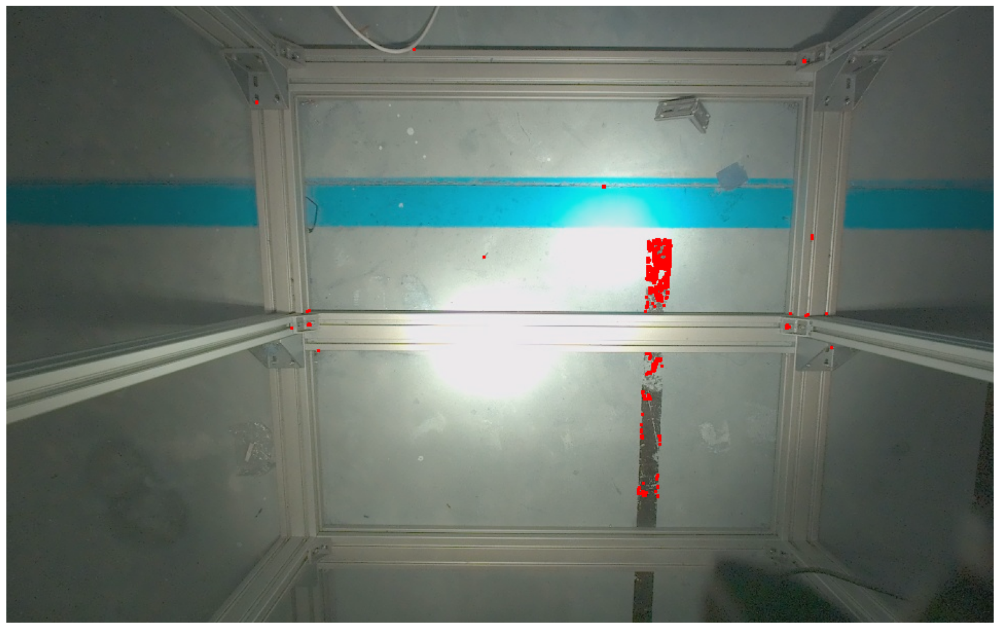

In [100]:
# HARRIS CORNER
dst = cv2.cornerHarris(np.float32(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)),2,1,0.04)
dst = cv2.dilate(dst, None)
result_img = img.copy()
result_img[dst>0.01*dst.max()]=[255,0,0]
plt_show(result_img, figsize=(20,20))

## SIFT (Scale Invarioant Deature Transform)

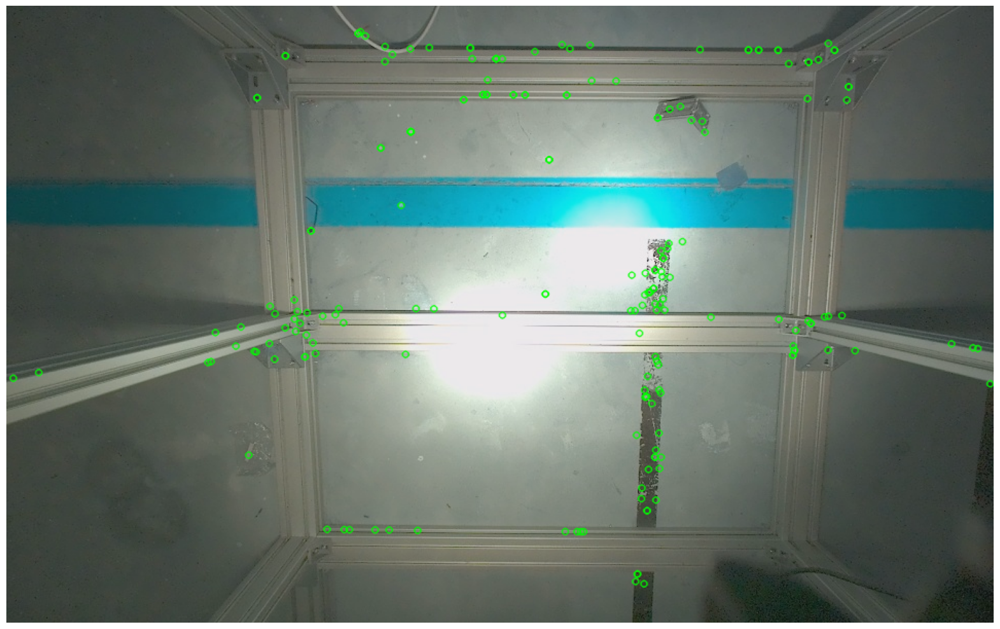

In [36]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()
kp = sift.detect(gray, None)

plt_show(
    cv2.drawKeypoints(img, kp, None, color=(0,255,0), flags=0),
    figsize=(20,20)
)

## FAST Detctor (Feature from Accelerated Segment Test)

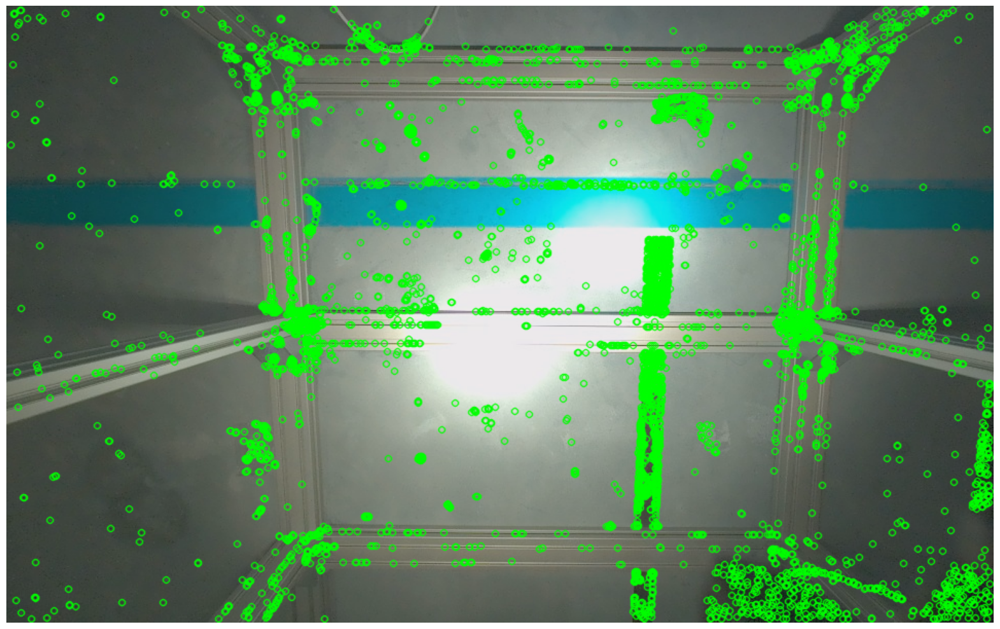

In [9]:
fast = cv2.FastFeatureDetector_create()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
fast.setNonmaxSuppression(0)
kp = fast.detect(gray, None)
plt_show(
    cv2.drawKeypoints(img, kp, None, color=(0,255,0), flags=0),
    figsize=(20,20)
)

## ORB (Oriented FAST and Roated BRIEF)

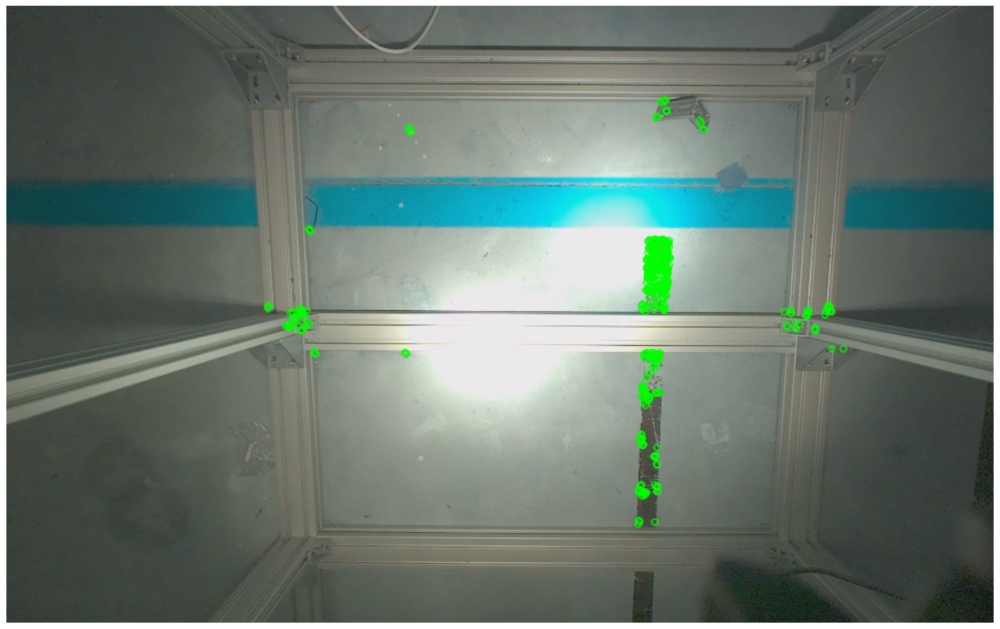

In [3]:
orb = cv2.ORB_create()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
kp = orb.detect(gray, None)
plt_show(
    cv2.drawKeypoints(img, kp, None, color=(0,255,0), flags=0),
    figsize=(20,20)
)

# Feature Matching

In [31]:
img_dir = Path("~/datasets/kitti/kitti_format/data_scene_flow_multiview/training/image_2/").expanduser()
img_list = [x for x in img_dir.iterdir()]
img_list = sorted(img_list)

## Brute Force Matcher

In [12]:
def bf_matcher(img1, img2, kp1, kp2, des1, des2, norm_type=cv2.NORM_HAMMING, no_of_matches=10):

    bf = cv2.BFMatcher(norm_type, crossCheck=True)

    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x:x.distance)
    img_comp = cv2.drawMatches(
        img1,
        kp1,
        img2,
        kp2,
        matches[:no_of_matches],
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )
    plt_show(img_comp, figsize=(40,40))

### With ORB

In [13]:
orb = cv2.ORB_create()

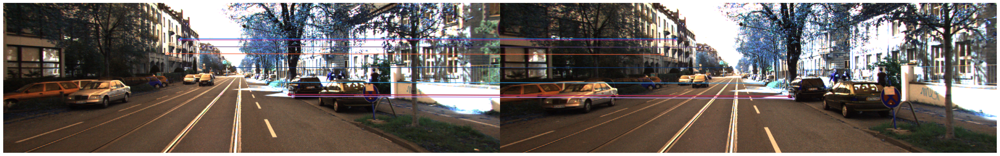

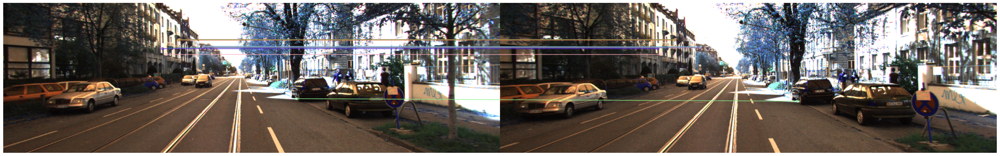

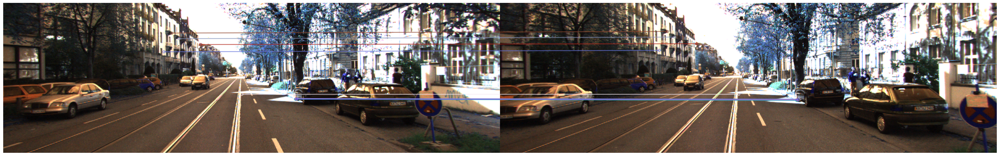

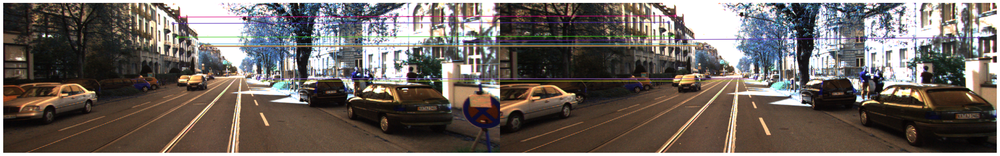

In [14]:
for i in range(4):
    kp1, des1 = orb.detectAndCompute(cv2.imread(str(img_list[i]),0), None)
    kp2, des2 = orb.detectAndCompute(cv2.imread(str(img_list[i+1]),0), None)
    matches = bf_matcher(cv2.imread(str(img_list[i])), cv2.imread(str(img_list[i+1])), kp1, kp2, des1, des2)

### With Harris
the biggest problem is that this is not scale invariant

In [4]:
def harris(img):
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_img = np.float32(gray_img)
    dst = cv2.cornerHarris(gray_img, 2,3, 0.04)
    keypoints = np.argwhere(dst > 0.01*dst.max())
    keypoints = [cv2.KeyPoint(float(x[1]), float(x[0]), 13) for x in keypoints]
    return keypoints

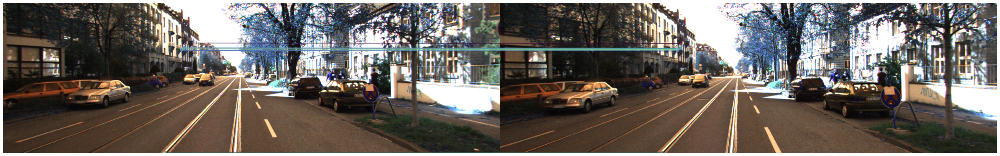

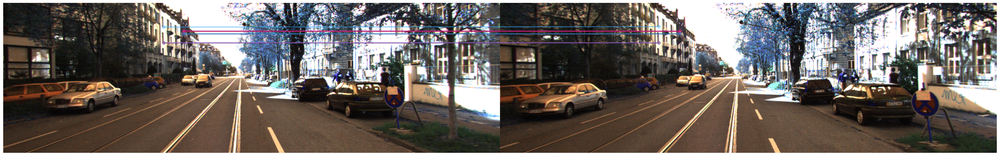

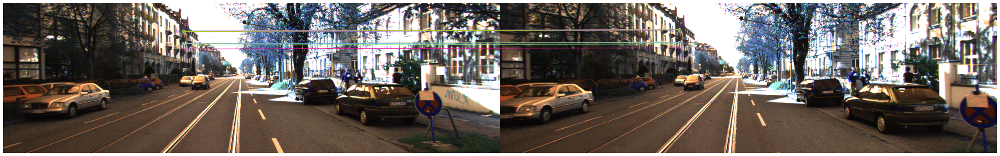

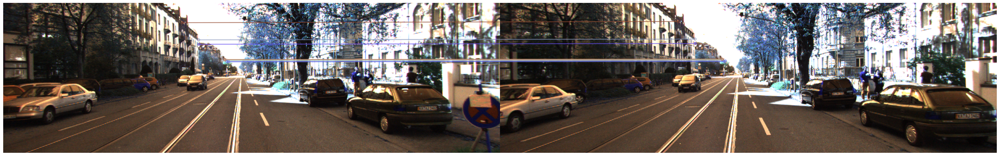

In [10]:
sift = cv2.SIFT_create()
for i in range(4):
    
    kp1 = harris(cv2.imread(str(img_list[i])))
    kp2 = harris(cv2.imread(str(img_list[i+1])))
    
    des1 = sift.compute(cv2.imread(str(img_list[i])), kp1)
    des2 = sift.compute(cv2.imread(str(img_list[i+1])), kp2)
    
    bf_matcher( cv2.imread(str(img_list[i])), cv2.imread(str(img_list[i+1])),kp1,kp2,des1[1],des2[1],norm_type=cv2.NORM_L2)

# Motion Estimation

In [3]:
img_dir = Path("~/datasets/kitti/kitti_format/data_scene_flow_multiview/training/image_2/").expanduser()
img_list = [x for x in img_dir.iterdir()]
img_list = sorted(img_list)

## Essential Matrix decomposition

In [4]:
orb = cv2.ORB_create()
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

In [5]:
gray1 = cv2.imread(str(img_list[0]))
gray2 = cv2.imread(str(img_list[1]))

In [6]:
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

In [7]:
matches = bf.match(des2, des1)

In [8]:
matches = sorted(matches, key=lambda x:x.distance)

In [9]:
pts1 = np.float32([kp1[m.queryIdx].pt for m in matches])
pts2 = np.float32([kp2[m.trainIdx].pt for m in matches])

In [10]:
P0 = np.array([9.842439e+02, 0.0, 6.900000e+02, 0.0,
               0.0, 9.808141e+02, 2.331966e+02, 0.0,
               0.0, 0.0, 1.0, 0.0]).reshape(3,4)
K = P0[:3, :3]

In [20]:
E, mask = cv2.findEssentialMat(pts1, pts2, K, method=cv2.RANSAC, prob=0.999, threshold=1.0)

In [12]:
_, R, t, mask = cv2.recoverPose(E, pts1, pts2, K)

In [32]:
pts1[mask.ravel() == 1]

TypeError: 'tuple' object is not callable

In [33]:
type(matches)

list